In [1]:
import pandas as pd
from gse.gse import create_model, instantiate_model, solve_model, get_results
from gse.gse_input import create_input
import matplotlib.pyplot as plt
import plotly.express as px

Get COIN-OR Cbc solver from https://github.com/coin-or/Cbc/releases. Other linear programming solvers can also work.

Set the solver path

In [2]:
solver = {'name':"cbc", 'path':"Path to solver"}

Import data

In [3]:
df_load = pd.read_csv('./examples/data/load.csv', index_col = 0, parse_dates = True)
df_pv = pd.read_csv('./examples/data/pv.csv', index_col = 0, parse_dates = True)
df_grid = pd.read_csv('./examples/data/grid.csv', index_col = 0, parse_dates = True)/100 # Convert €¢/kWh --> €/kWh
df_battery = pd.read_csv('./examples/data/battery.csv', index_col = 0)

Data consist of the load and PV generation time-series of the energy community houses and the parameter values of the batteries. Data also include the grid costs time-series.

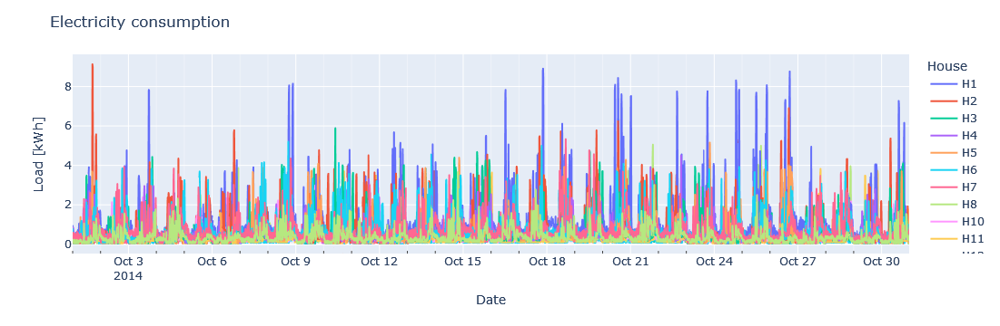

In [4]:
fig = px.line(df_load, x=df_load.index, y=df_load.columns)
fig.update_xaxes(minor=dict(ticks="inside", showgrid=True))
fig.update_layout(
    title = dict(text='Electricity consumption'),
    yaxis_title=dict(text='Load [kWh]'),
    xaxis_title=dict(text='Date'),
    legend_title_text='House'
)
fig.show()

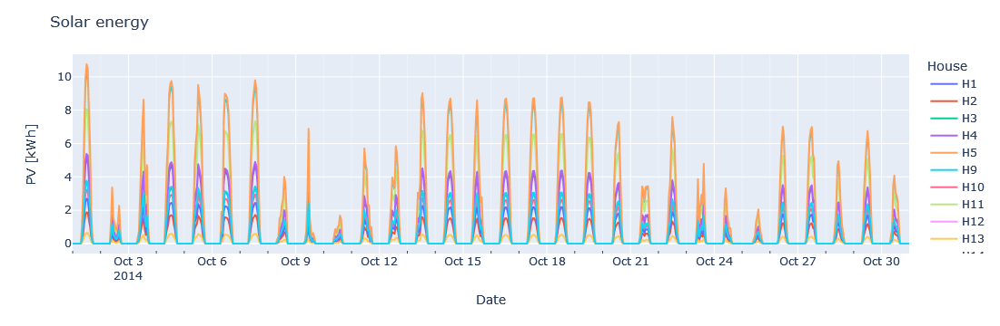

In [5]:
fig = px.line(df_pv, x=df_pv.index, y=df_pv.columns)
fig.update_xaxes(minor=dict(ticks="inside", showgrid=True))
fig.update_layout(
    title = dict(text='Solar energy'),
    yaxis_title=dict(text='PV [kWh]'),
    xaxis_title=dict(text='Date'),
    legend_title_text='House'
)
fig.show()

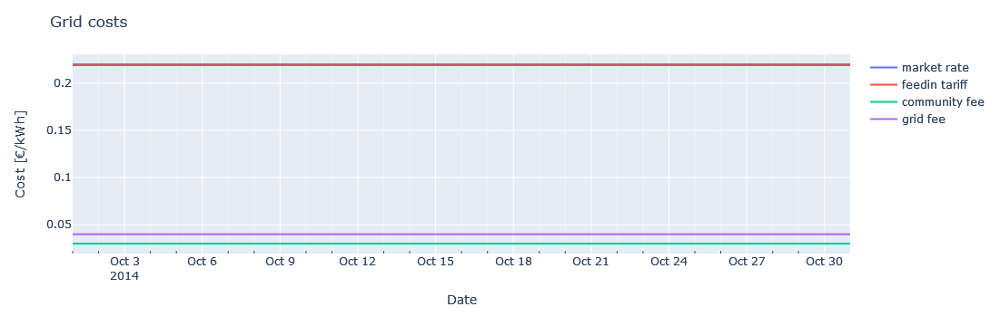

In [6]:
fig = px.line(df_grid, x=df_grid.index, y=df_grid.columns)
fig.update_xaxes(minor=dict(ticks="inside", showgrid=True))
fig.update_layout(
    title = dict(text='Grid costs'),
    yaxis_title=dict(text='Cost [€/kWh]'),
    xaxis_title=dict(text='Date'),
    legend_title_text=''
)
fig.show()

In [7]:
df_battery

,H1,H2,H3,H4,H10,H14,H16,H20
Parameter,,,,,,,,
capacity,10.000,4.0,6.0,12.000,6.00,6.000,6.0,6.000
min soc,0.000,0.0,0.0,0.000,0.00,0.000,0.0,0.000
charging power,5.451,4.0,6.0,5.055,4.16,4.816,6.0,3.738
discharging power,5.451,4.0,6.0,5.055,4.16,4.816,6.0,3.738
charging efficiency,1.000,1.0,1.0,1.000,1.00,1.000,1.0,1.000
discharging efficiency,1.000,1.0,1.0,1.000,1.00,1.000,1.0,1.000


Create and solve the energy community optimization model

In [ ]:
# Create data input for model
model_data = create_input(df_load,df_pv,df_grid,df_battery)
# Create model
mdl = create_model()
# Instantiate model with data
m = instantiate_model(mdl, model_data)
# Solve model
s = solve_model(m, solver) 
# Get solution as python dictionary
sd = get_results(s)

Get solution into dataframes

In [9]:
df_power_buy = pd.DataFrame(index = df_load.index, columns=sd['power_buy'].keys())
for c in sd['power_buy'].keys():
    df_power_buy.loc[:,c] = sd['power_buy'][c]

df_power_sell = pd.DataFrame(index = df_load.index, columns=sd['power_sell'].keys())
for c in sd['power_sell'].keys():
    df_power_sell.loc[:,c] = sd['power_sell'][c]

df_battery_soc = pd.DataFrame(index = df_load.index, columns=sd['battery_soc'].keys())
for c in sd['battery_soc'].keys():
    df_battery_soc.loc[:,c] = sd['battery_soc'][c]

df_battery_charge = pd.DataFrame(index = df_load.index, columns=sd['battery_charge'].keys())
for c in sd['battery_charge'].keys():
    df_battery_charge.loc[:,c] = sd['battery_charge'][c]

df_battery_discharge = pd.DataFrame(index = df_load.index, columns=sd['battery_discharge'].keys())
for c in sd['battery_discharge'].keys():
    df_battery_discharge.loc[:,c] = sd['battery_discharge'][c]

df_cost_energy = pd.DataFrame(index = df_load.index, data=sd['cost_energy'])
df_cost_grid = pd.DataFrame(index = df_load.index, data=sd['cost_grid'])
df_cost_total = df_cost_energy + df_cost_grid

The following plot shows the time-series of the houses energy imports

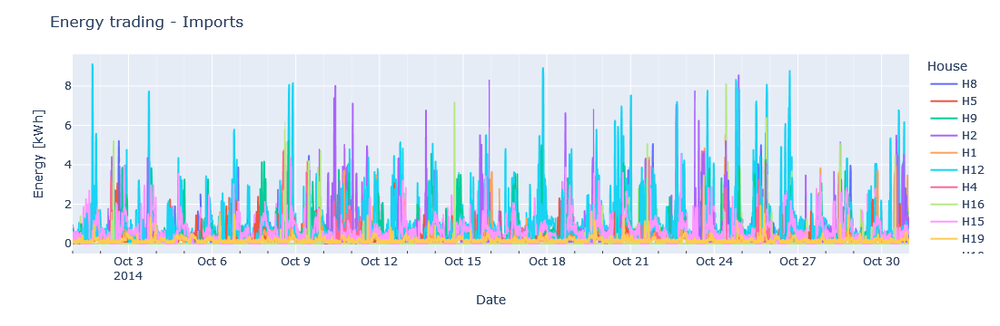

In [10]:
fig = px.line(df_power_buy, x=df_power_buy.index, y=df_power_buy.columns)
fig.update_xaxes(minor=dict(ticks="inside", showgrid=True))
fig.update_layout(
    title = dict(text='Energy trading - Imports'),
    yaxis_title=dict(text='Energy [kWh]'),
    xaxis_title=dict(text='Date'),
    legend_title_text='House'
)
fig.show()

The following plot shows the time-series of the houses energy exports

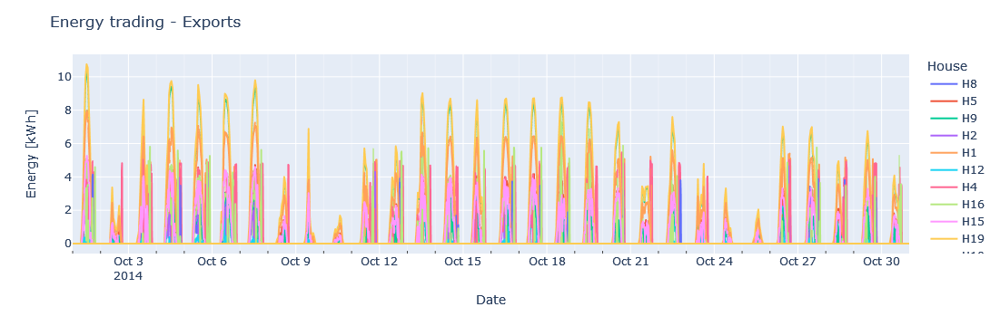

In [11]:
fig = px.line(df_power_sell, x=df_power_sell.index, y=df_power_sell.columns)
fig.update_xaxes(minor=dict(ticks="inside", showgrid=True))
fig.update_layout(
    title = dict(text='Energy trading - Exports'),
    yaxis_title=dict(text='Energy [kWh]'),
    xaxis_title=dict(text='Date'),
    legend_title_text='House'
)
fig.show()

The following plot shows the time-series of the batteries state-of-charge

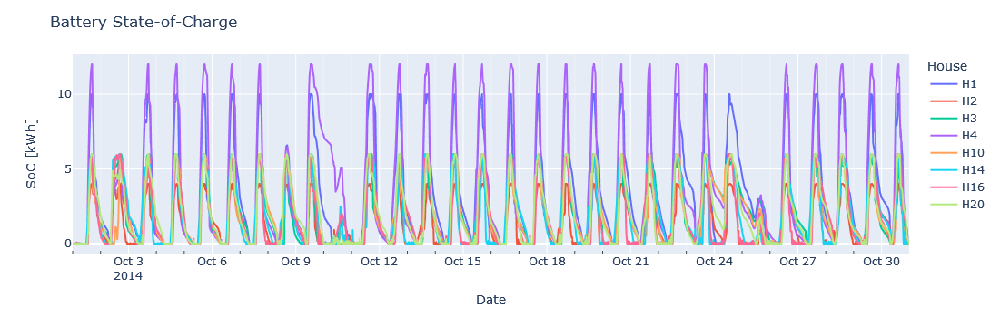

In [12]:
fig = px.line(df_battery_soc, x=df_battery_soc.index, y=df_battery_soc.columns)
fig.update_xaxes(minor=dict(ticks="inside", showgrid=True))
fig.update_layout(
    title = dict(text='Battery State-of-Charge'),
    yaxis_title=dict(text='SoC [kWh]'),
    xaxis_title=dict(text='Date'),
    legend_title_text='House'
)
fig.show()

The following plot shows the time-series of the operation costs. These include the energy cost/profit from buying/selling energy, the cost of the grid and the total cost as the sum of the energy and grid costs.

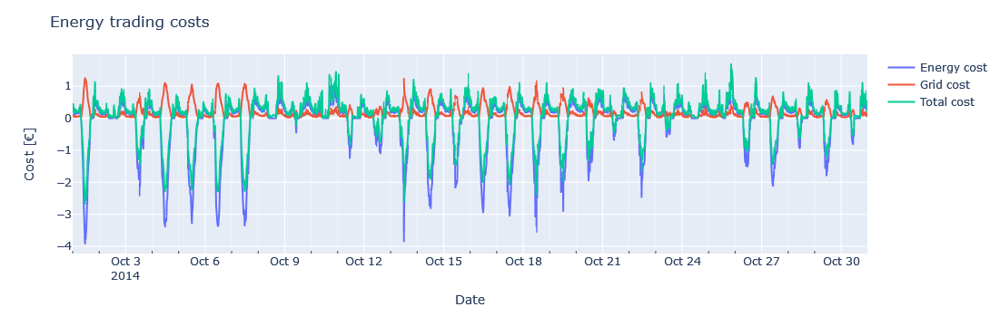

In [13]:
fig = px.line(df_cost_energy, x=df_cost_energy.index, y=[df_cost_energy[0], df_cost_grid[0], df_cost_total[0]])
fig.update_xaxes(minor=dict(ticks="inside", showgrid=True))
fig.update_layout(
    title = dict(text='Energy trading costs'),
    yaxis_title=dict(text='Cost [€]'),
    xaxis_title=dict(text='Date'),
    legend_title_text=''
)
for i,trace in enumerate (fig.data):
    trace.update(name=['Energy cost','Grid cost','Total cost'][i])
fig.show()

The total costs over the whole operation period (Oct 2018) are:

In [14]:
print('Energy cost:', df_cost_energy.sum().round(2)[0], '€')
print('Grid cost:', df_cost_grid.sum().round(2)[0], '€')
print('Total cost:', df_cost_total.sum().round(2)[0], '€')

Energy cost: -385.92 €
Grid cost: 510.88 €
Total cost: 124.97 €
